# Project 01 - Registration
In this project, we would like you to investigate image registration. For this purpose, we will give you a batch of unregistered brain images from our research group. Your task is to apply the methods from the lecture and transform these images onto each other to obtain a 3D representation of the original brain.

![A stack of images](./supplementary/stacking.png)

You can find and download the images at: [Sciebo](https://fz-juelich.sciebo.de/index.php/apps/files?dir=/2023-ss-ComputerVision/public/exercises/project_01-registration&fileid=1234975508)

Image registration consists of five steps:
1. detecting image features (you can use feature detectors provided by scikit-image or OpenCV).
2. matching of these image features (use and implement the matching algorithm described in the lecture)
3. removing outliers (use the RANSAC method to remove outliers)
4. calculate a transformation (the calculation of a transformation from the feature points and matches was described in the exercise)
5. transform the image (use backwards mapping to transform the image)

To register the entire batch, you need to go through the images and link the transformations together

Tipps and hints:
1. Start with just two images, generalize it and then apply it to all images
2. It may be useful to start with just translations and then work your way up to more complex transformations
3. There are non-linearities in the deformed images, so don't expect to align them perfectly
4. It can help to visualize the feature points detected and the matches found.

In [1]:
# Basic imports
import numpy as np
import tifffile as tiff
import matplotlib.pyplot as plt
import glob
import math
from time import time

In [2]:
# load the images
images = [tiff.imread(name) for name in sorted(glob.glob("./images/tiff/*.tif"))]

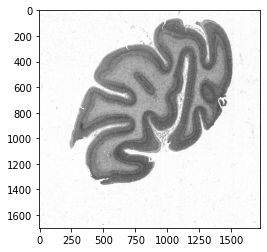

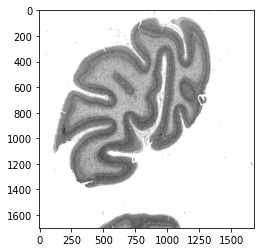

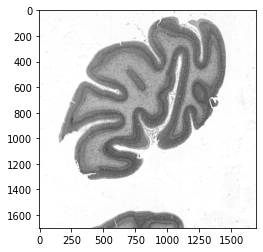

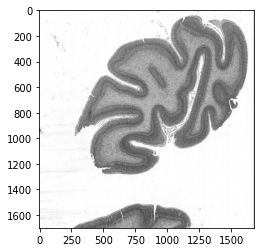

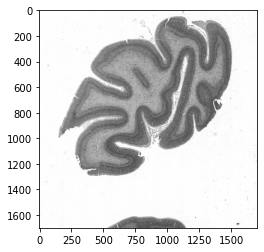

...

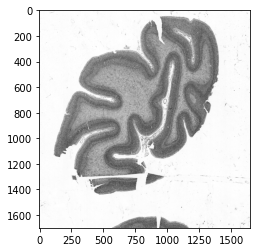

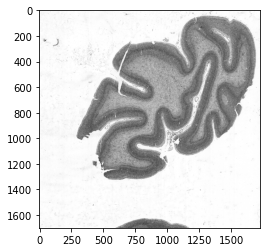

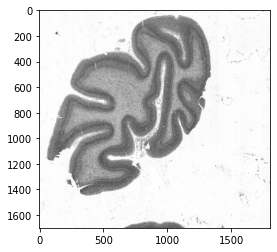

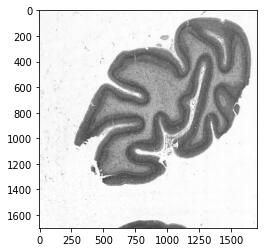

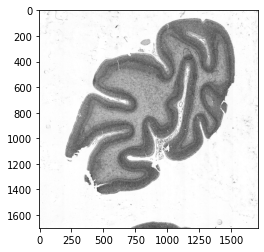

In [3]:
# plot the image
for image in images:
    plt.imshow(image, cmap="gray")
    plt.show()

## Keypoint Detection

We detect the keypoints using the SIFT algorithm in the scikit-image or opencv library. To reduce the number of points found from 8000 to around 500, we blur the image beforhand, to reduce the noise in the image.

In [4]:
from scipy.ndimage import gaussian_filter
from skimage.feature import SIFT
try:
    import cv2
    OPENCV = True
except:
    OPENCV = False
    
def get_keypoints(image, filtering=True, sigma=3):
    """ returns the keypoints of the image using the SIFT algorithm """
    # apply an optional smoothing to reduce the amount of found keypoints
    if filtering:
        image = gaussian_filter(image, sigma=sigma)
    
    # initialize the extractor and detect the keypoints
    if OPENCV:
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(image, None)
        # transform keypoints to numpy array
        keypoints = np.array([list(keypoints[i].pt)[::-1] for i in range(len(keypoints))])
    else:
        descriptor_extractor = SIFT()
        descriptor_extractor.detect_and_extract(image)
        keypoints, descriptors = descriptor_extractor.keypoints, descriptor_extractor.descriptors
    
    # return the keypoints and the descriptors
    return keypoints, descriptors

## Matching

We implemented a simple distance based matching of the descriptors. A match is valid, when it is significantly better than the second best match, signifiance can be defined by the ratio of distance 1 / distance 2. We also implemented cross-checking, a match is only valid, if it is a significant match for both points.

![An image of the matching process](./supplementary/matching.png)

To compute the distances between all descriptors quickly we use scipy.spatial.distance.cdist(). Getting the two smallest distances for each match, we can use numpy.argpartition (this function sorts the array only up to the kth smallest entry. It runs in O(n + k*log(k)).

In [5]:
from scipy.spatial.distance import cdist

def intersect2d(array1, array2):
    """ calculates the intersection over the rows of two arrays """
    # tests which entries are the same
    test = array1[:, None] == array2  # needs [:, None] to induce broadcasting 
    
    # selects only the entries, for which the
    return array2[np.all(test.mean(0) > 0, axis = 1)]
    
    
def matching(descriptors_1, descriptors_2, max_ratio=0.7, cross_checking=True):
    """ Matches the descriptors against each other. 
        Returns the best match for each descriptor, if it is significant.
        The significance is defined by the max_ratio: distance_1 / distance_2 < max_ratio.
        Optional cross-checking of matches.
    """
    # calculate the distance between all pairs
    distance_matrix = cdist(descriptors_1, descriptors_2)
    
    # get the first and second match (only sorts up to the kth smallest entry, in O(n + k log(k)))
    matches, distances = np.argpartition(distance_matrix, 2, axis=1)[:, :2], np.partition(distance_matrix, 2, axis=1)[:, :2]
    if cross_checking:
        matches2, distances2 = np.argpartition(distance_matrix.T, 2, axis=1)[:, :2], np.partition(distance_matrix.T, 2, axis=1)[:, :2]
    
    # get the ratios
    ratios = distances[:, 0] / distances[:, 1]
    if cross_checking:
        ratios2 = distances2[:, 0] / distances2[:, 1]
    
    # cutoff at max_ratio
    mask = ratios < max_ratio
    if cross_checking:
        mask2 = ratios2 < max_ratio
    
    # produce the final matches
    final_matches = np.stack((np.arange(descriptors_1.shape[0])[mask], matches[mask, 0])).T
    if cross_checking:
        final_matches2 = np.stack((np.arange(descriptors_2.shape[0])[mask2], matches2[mask2, 0])).T
    
    # cross_checking
    if cross_checking:
        # return the intersection of the two matches arrays (invert final_matches2 to point in the same direction)
        final_matchs = intersect2d(final_matches, final_matches2[:, ::-1])
    
    
    return final_matches

## Calculating an affine transformation

To caculate the affine transformation we simply solve the least-squares problem A.T@Ax = A.Tb. With A being the input points and b being the output points.

In [6]:
def get_affine_transformation(points_in, points_out):
    # transform to homogenous coordinates
    points_in = np.hstack((points_in, np.ones((len(points_in), 1))))
    points_out = np.hstack((points_out, np.ones((len(points_out), 1))))
    
    # solve the least-squares problem A.T@Ax = A.Tb
    resulting = np.linalg.solve(points_in.T @ points_in, points_in.T @ points_out)

    return np.round(resulting.T, decimals=5)


In [7]:
def transform_points(points, matrix):
    # homogneous coordinates
    points = np.hstack((points, np.ones((len(points), 1))))
    
    # transform the points
    points = (matrix @ points.T).T[:, :2]
    
    return points

## RANSAC

Random Sample Consensus is a simple algorithm to predict a robust model on a set with outliers. We sample k points in each iteration and calculate a model based on these points. Next we calculate the number of supporters for this model, this is defined by some cutoff residuum. We return the model with the most support in the group.

One adaptation we used here is to increase k from 3 to 4 which smooths the calculated affine transformations and improves the robustness.

In [8]:
def ransac(points_in, points_out, matches, percentage_outliers=0.5, probability=0.99, cutoff=20, k=3):
    N = matches.shape[0]
    # calculate the number of iterations
    S = int(np.ceil(np.log(1 - probability) / np.log(1 - (1 - percentage_outliers)**k)))
    
    # sample the best model
    inlier_best = None
    support_best = 0
    for i in range(S):
        # sample k matches
        samples = np.random.choice(N, size=k, replace=False)
        
        # calculate the model
        model = get_affine_transformation(points_in[matches[samples, 0]], points_out[matches[samples, 1]])
        
        # transform the points
        points_transformed = transform_points(points_in, model)
        
        # calculate the residuuals
        residuum = np.linalg.norm(points_out[matches[:, 1]] - points_transformed[matches[:, 0]], axis=1)
        
        # calculate the supporter percentage
        inlier_temp = residuum < cutoff
        support_temp = inlier_temp.mean()
        
        # update the best model and inlier percentage
        if support_temp > support_best:
            inlier_best = inlier_temp
            support_best = support_temp
    
    # return the inliers
    return matches[inlier_best], support_best

## Transforming the images

We will use backwards mapping for the image transformation. To run it efficiently we use advanced numpy array indexing.

In [9]:
def backwards_mapping(image, output_shape, transformation, background=0):
    # create the points of the new image
    y_range, x_range = np.arange(output_shape[0], dtype="int"), np.arange(output_shape[1], dtype="int")
    XX, YY = np.meshgrid(x_range, y_range)
    points = np.empty((output_shape[0] * output_shape[1], 2), dtype="float32")
    points[:, 0] = YY.ravel()
    points[:, 1] = XX.ravel()
                     
    # transform the points into the original image
    transformed_points = transform_points(points, transformation).astype("int")
    transformed_points = transformed_points.reshape(output_shape[:2] + (2,))

    # remove all points, that land outside the original image
    in_image = (((transformed_points[:, :, 0]) >= 0) & (transformed_points[:, :, 0] < image.shape[0])) & \
               (((transformed_points[:, :, 1]) >= 0) & (transformed_points[:, :, 1] < image.shape[1]))
    
    # write the pixel values at the correct location
    output_image = background * np.ones(output_shape, dtype=image.dtype)
    output_image[in_image] = image[transformed_points[in_image, 0], transformed_points[in_image, 1]]

    return output_image

## Concatenate transformations

First we calculate the affine transformations between all neighbouring pairs. Then, to transform e.g. the second image we first apply $T_2$ then $T_1$ or $T_1 \cdot T_2$.

![Showing the iterative transformation process](./supplementary/iterative.gif)

The problem with this approach are error propagations. E.g. an error between the first image pair, will be present in the whole following stack.

## Putting it all together

In [10]:
def transform_a_stack(images):
    """ transforms a complete stack in one go """
    f_total = time()
    n = len(images)
    stack_shape = images[0].shape
    
    # calculate the keypoints and descriptors
    print(f"Calculating the keypoints")
    f = time()
    keypoints = []  # n
    descriptors = []
    for image in images:
        kps, desc = get_keypoints(image)
        keypoints.append(kps)
        descriptors.append(desc)
    print(f"Done in {time() - f:0.4f} seconds")
    
    # run the matching
    print(f"Match the descriptors")
    f = time()
    matches = []  # n-1
    for i in range(n-1):
        matches.append(matching(descriptors[i], descriptors[i+1]))
    print(f"Done in {time() - f:0.4f} seconds")
    
    # filter the matches using the RANSAC
    print(f"Filter matches with the RANSAC")
    f = time()
    matches_filtered = []  # n-1
    for i in range(n-1):
        mts_filtered, _ = ransac(keypoints[i], keypoints[i+1], matches[i], percentage_outliers=0.1, probability=0.99, cutoff=20, k=4)
        matches_filtered.append(mts_filtered)
    print(f"Done in {time() - f:0.4f} seconds")
        
    # calculate the affine transformation for each image
    print(f"Calculate the affine transformations")
    f = time()
    affine_transformations = []  # n-1
    for i in range(n-1):
        affine_transformations.append(
            get_affine_transformation(
                keypoints[i+0][matches_filtered[i][:, 0]],
                keypoints[i+1][matches_filtered[i][:, 1]],
            )
        )
    print(f"Done in {time() - f:0.4f} seconds")
    
    # transform the stack
    print(f"Applying the affine transformations")
    f = time()
    transformation = np.eye(3)
    new_stack = np.empty((n,) + stack_shape, dtype=np.uint8)
    new_stack[0] = images[0]
    for i in range(n-1):
        # concatenate the transformation
        transformation = transformation @ affine_transformations[i]
        
        # apply the transformation
        new_stack[i+1] = backwards_mapping(images[i+1], stack_shape, transformation, background=255)
    print(f"Done in {time() - f:0.4f} seconds")
    
    print(f"Finished in {time() - f_total:0.4f} seconds")
    return new_stack

In [11]:
f = time()
new_stack = transform_a_stack(images)


Calculating the keypoints
Done in 8.1471 seconds
Match the descriptors
Done in 0.2944 seconds
Filter matches with the RANSAC
Done in 0.0068 seconds
Calculate the affine transformations
Done in 0.0005 seconds
Applying the affine transformations
Done in 3.0981 seconds
Finished in 11.5471 seconds


## Plot the images

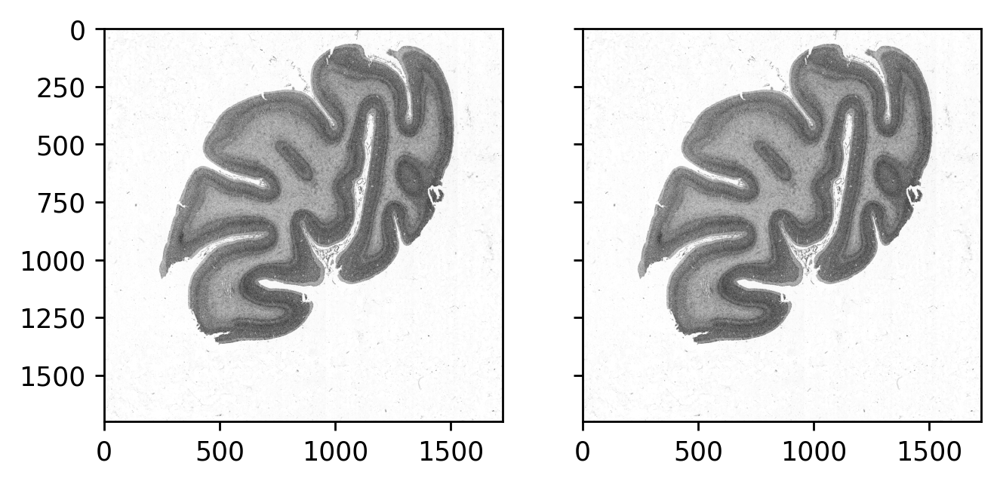

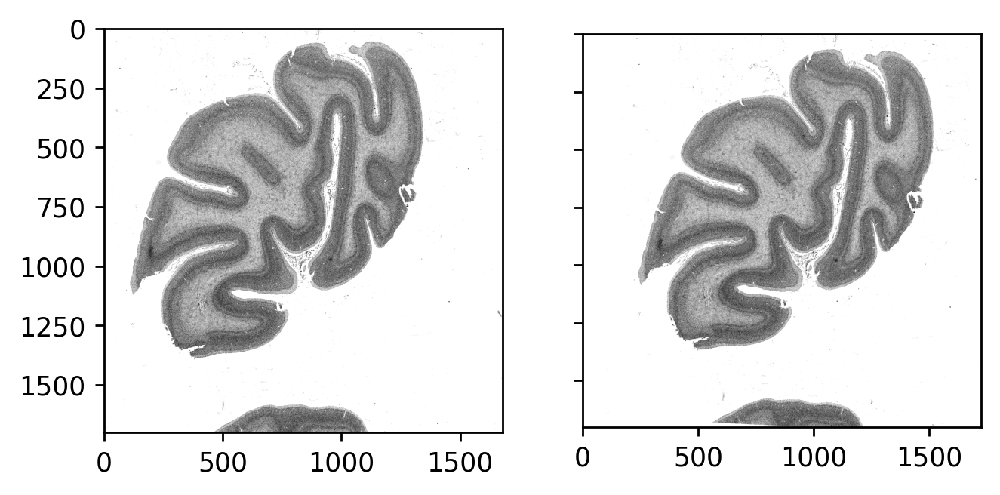

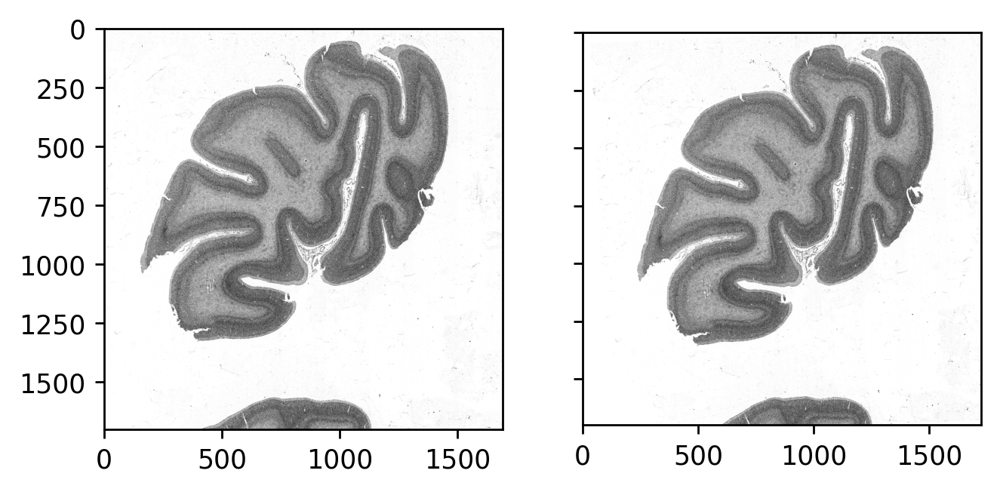

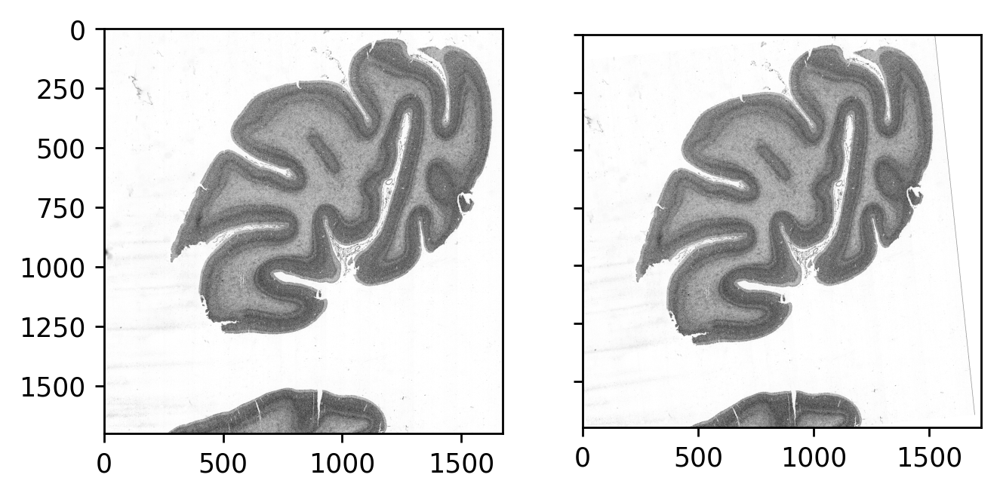

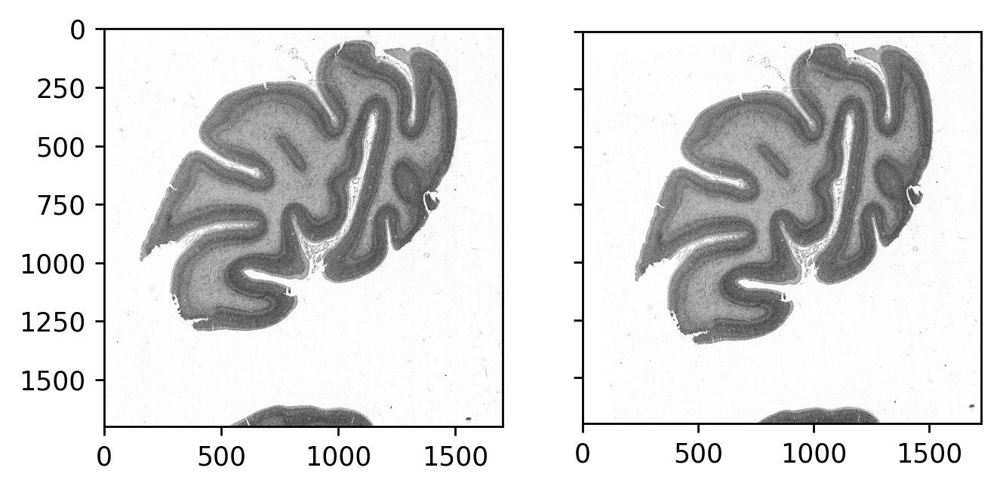

...

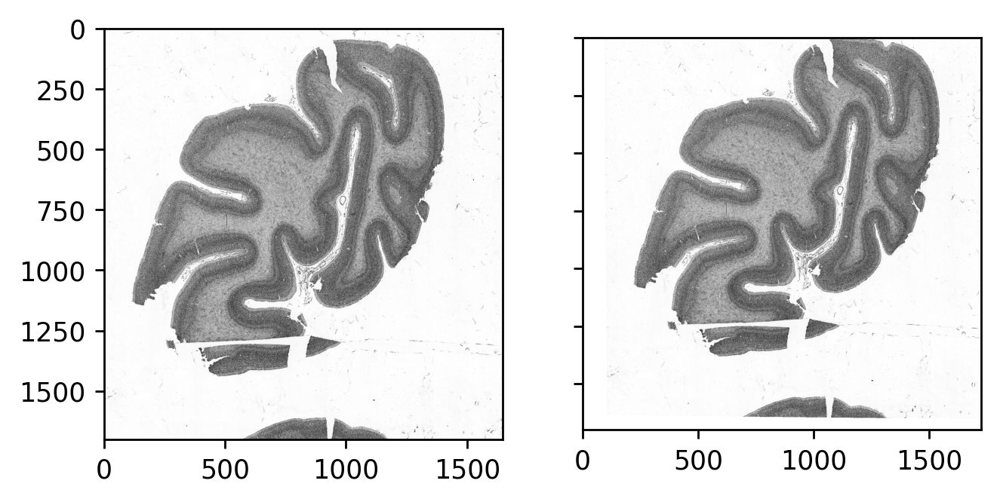

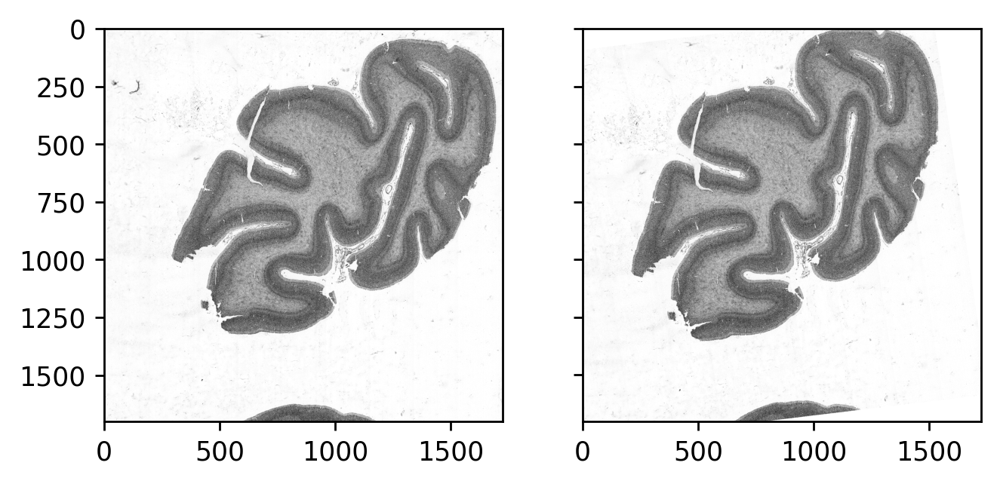

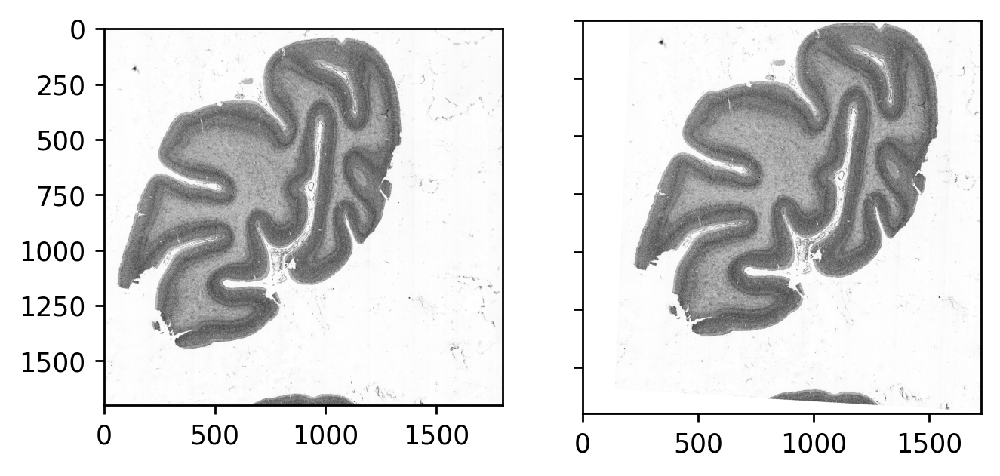

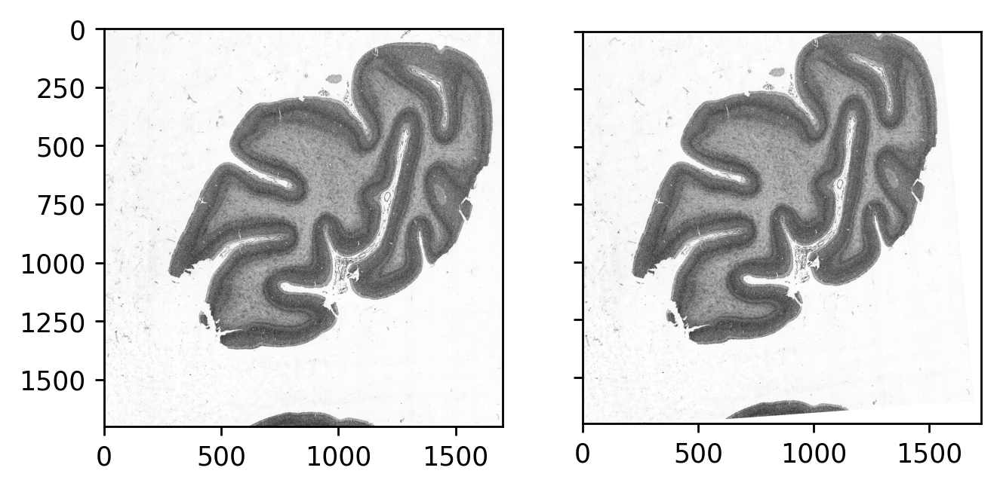

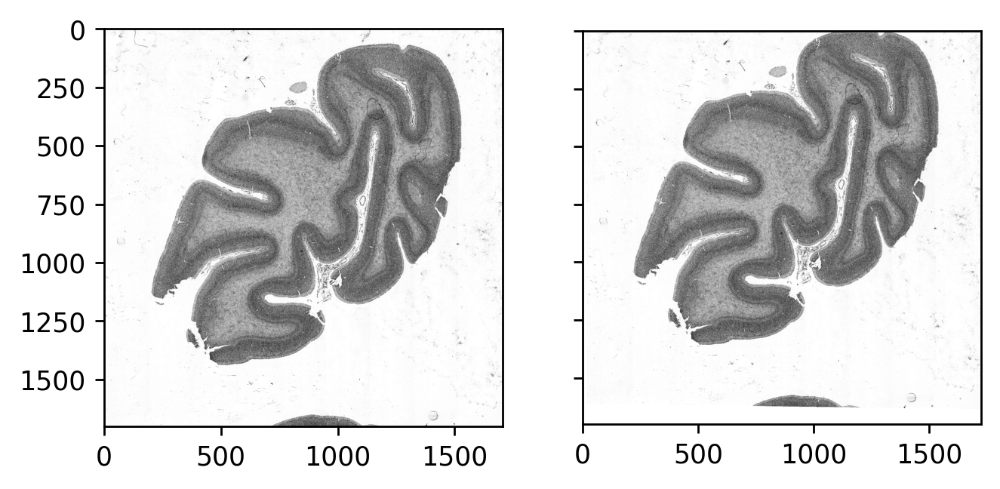

In [12]:
# plot the stack in a simple way
for i in range(len(images)):
    fig, axes = plt.subplots(1, 2, sharey=True, dpi=250)
    
    axes[0].imshow(images[i], cmap="gray")
    axes[1].imshow(new_stack[i], cmap="gray")
    plt.show()

## Write the images to disk

In [13]:
for i in range(new_stack.shape[0]):
    tiff.imwrite(f"./images/out/transformed_0{429+i}.tiff", new_stack[i])

## Show error propagation

In order to approximate error propagation, we will calculate matches between the first image and all transformed images. The average matching distance is the error.

In [14]:
def calculate_matching_distances(stack):
    n = len(stack)
    # calculate the keypoints and descriptors
    print(f"Calculating the keypoints")
    f = time()
    keypoints = []  # n
    descriptors = []
    for image in stack:
        kps, desc = get_keypoints(image)
        keypoints.append(kps)
        descriptors.append(desc)
    print(f"Done in {time() - f:0.4f} seconds")

    # run the matching
    print(f"Match the descriptors")
    f = time()
    matches = []  # n-1
    for i in range(n-1):
        matches.append(matching(descriptors[0], descriptors[i+1]))
    print(f"Done in {time() - f:0.4f} seconds")

    # filter the matches using the RANSAC
    print(f"Filter matches with the RANSAC")
    f = time()
    matches_filtered = []  # n-1
    for i in range(n-1):
        mts_filtered, _ = ransac(keypoints[0], keypoints[i+1], matches[i], percentage_outliers=0.1, probability=0.99, cutoff=20, k=4)
        matches_filtered.append(mts_filtered)
    print(f"Done in {time() - f:0.4f} seconds")

    # calculate the average matching distance
    print(f"Calculating the average matching distance")
    f = time()
    errors = np.empty(n-1)
    for i in range(n-1):
        errors[i] = np.mean(np.linalg.norm(keypoints[0][matches_filtered[i][:, 0]] - keypoints[i+1][matches_filtered[i][:, 1]], axis=1))
    print(f"Done in {time() - f:0.4f} seconds") 
        
    return errors

In [15]:
errors = calculate_matching_distances(new_stack)

Calculating the keypoints
Done in 8.4636 seconds
Match the descriptors
Done in 0.2797 seconds
Filter matches with the RANSAC
Done in 0.0063 seconds
Calculating the average matching distance
Done in 0.0002 seconds


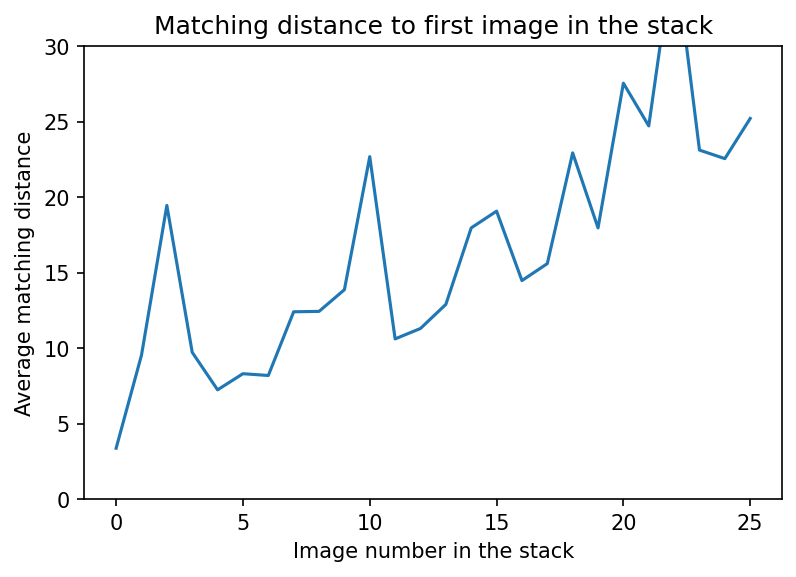

In [16]:
plt.figure(dpi=150)
plt.plot(errors)
plt.title("Matching distance to first image in the stack")
plt.xlabel("Image number in the stack")
plt.ylabel("Average matching distance")
plt.ylim(0, 30)
plt.show()